In [3]:
!pip install geopandas

   ---------------------------------------- 0.0/19.2 MB ? eta -:--:--
    --------------------------------------- 0.3/19.2 MB ? eta -:--:--
   --- ------------------------------------ 1.6/19.2 MB 3.5 MB/s eta 0:00:06
   ---- ----------------------------------- 2.1/19.2 MB 3.3 MB/s eta 0:00:06
   ----- ---------------------------------- 2.6/19.2 MB 3.4 MB/s eta 0:00:05
   ------- -------------------------------- 3.4/19.2 MB 3.2 MB/s eta 0:00:05
   ------- -------------------------------- 3.7/19.2 MB 3.1 MB/s eta 0:00:06
   --------- ------------------------------ 4.7/19.2 MB 3.3 MB/s eta 0:00:05
   ---------- ----------------------------- 5.2/19.2 MB 3.2 MB/s eta 0:00:05
   ----------- ---------------------------- 5.8/19.2 MB 3.0 MB/s eta 0:00:05
   ------------- -------------------------- 6.3/19.2 MB 2.9 MB/s eta 0:00:05
   ------------- -------------------------- 6.6/19.2 MB 2.8 MB/s eta 0:00:05
   -------------- ------------------------- 7.1/19.2 MB 2.7 MB/s eta 0:00:05
   ----------


[notice] A new release of pip is available: 25.1.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [5]:
!pip install xarray

   ---------------------------------------- 0.0/1.2 MB ? eta -:--:--
   ---------------------------------------- 0.0/1.2 MB ? eta -:--:--
   ---------------------------------------- 0.0/1.2 MB ? eta -:--:--
   -------- ------------------------------- 0.3/1.2 MB ? eta -:--:--
   ----------------- ---------------------- 0.5/1.2 MB 989.2 kB/s eta 0:00:01
   -------------------------- ------------- 0.8/1.2 MB 884.1 kB/s eta 0:00:01
   -------------------------- ------------- 0.8/1.2 MB 884.1 kB/s eta 0:00:01
   ----------------------------------- ---- 1.0/1.2 MB 883.6 kB/s eta 0:00:01
   ---------------------------------------- 1.2/1.2 MB 780.8 kB/s eta 0:00:00



[notice] A new release of pip is available: 25.1.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [8]:
!pip install rioxarray


[notice] A new release of pip is available: 25.1.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [11]:
!pip install earthpy


[notice] A new release of pip is available: 25.1.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [18]:
from functools import partial
import os

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras
import sklearn.metrics

import os
from PIL import Image
from glob import glob
import matplotlib.pyplot as plt
import numpy as np
import geopandas as gpd
import xarray as xr
import time
import statistics
import rioxarray as rxr
import earthpy as et
import earthpy.spatial as es
import earthpy.plot as ep
import numpy as np
import numpy.ma as ma
import matplotlib.pyplot as plt
from matplotlib import patches as mpatches
from matplotlib.colors import ListedColormap
from mpl_toolkits.axes_grid1 import make_axes_locatable
from skimage import exposure
import earthpy.spatial as es
import rasterio
from rasterio.plot import show
from tqdm.notebook import tqdm 
import math
from sklearn.metrics import silhouette_score 
from sklearn.datasets import make_blobs 
from sklearn.metrics import davies_bouldin_score


In [19]:
images_dir = 'E:\software and apps\sourav activity\Desktop\Code\Clip'
masks_dir = 'E:\software and apps\sourav activity\Desktop\Code\Clip'

dirname, _, filenames = next(os.walk(images_dir))

In [20]:
@tf.function
def load_img_with_mask(image_path, images_dir: str = 'Images', masks_dir: str = 'Masks',images_extension: str = 'jpg', masks_extension: str = 'jpg') -> dict:
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)

    mask_filename = tf.strings.regex_replace(image_path, images_dir, masks_dir)
    mask_filename = tf.strings.regex_replace(mask_filename, images_extension, masks_extension)
    mask = tf.io.read_file(mask_filename)
    mask = tf.image.decode_image(mask, channels=1, expand_animations = False)
    return (image, mask)

In [16]:
%matplotlib inline
n_examples = 3
examples = [load_img_with_mask(os.path.join(images_dir, filenames[i])) for i in range(n_examples)]

fig, axs = plt.subplots(n_examples, 2, figsize=(14, n_examples*7), constrained_layout=True)
for ax, (image, mask) in zip(axs, examples):
    ax[0].imshow(image)
    ax[1].imshow(mask)

InvalidArgumentError: Graph execution error:

Detected at node decode_image/DecodeImage defined at (most recent call last):
  File "E:\software and apps\sourav activity\Desktop\Python\lib\runpy.py", line 197, in _run_module_as_main

  File "E:\software and apps\sourav activity\Desktop\Python\lib\runpy.py", line 87, in _run_code

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\ipykernel_launcher.py", line 18, in <module>

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\traitlets\config\application.py", line 1075, in launch_instance

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\ipykernel\kernelapp.py", line 739, in start

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\tornado\platform\asyncio.py", line 211, in start

  File "E:\software and apps\sourav activity\Desktop\Python\lib\asyncio\base_events.py", line 601, in run_forever

  File "E:\software and apps\sourav activity\Desktop\Python\lib\asyncio\base_events.py", line 1905, in _run_once

  File "E:\software and apps\sourav activity\Desktop\Python\lib\asyncio\events.py", line 80, in _run

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\ipykernel\kernelbase.py", line 545, in dispatch_queue

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\ipykernel\kernelbase.py", line 534, in process_one

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\ipykernel\kernelbase.py", line 437, in dispatch_shell

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\ipykernel\ipkernel.py", line 362, in execute_request

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\ipykernel\kernelbase.py", line 778, in execute_request

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\ipykernel\ipkernel.py", line 449, in do_execute

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\ipykernel\zmqshell.py", line 549, in run_cell

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\IPython\core\interactiveshell.py", line 3048, in run_cell

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\IPython\core\interactiveshell.py", line 3103, in _run_cell

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\IPython\core\async_helpers.py", line 129, in _pseudo_sync_runner

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\IPython\core\interactiveshell.py", line 3308, in run_cell_async

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\IPython\core\interactiveshell.py", line 3490, in run_ast_nodes

  File "E:\software and apps\sourav activity\Desktop\Python\lib\site-packages\IPython\core\interactiveshell.py", line 3550, in run_code

  File "C:\Users\Sourav Das\AppData\Local\Temp\ipykernel_11384\2591891176.py", line 3, in <module>

  File "C:\Users\Sourav Das\AppData\Local\Temp\ipykernel_11384\2591891176.py", line 3, in <listcomp>

  File "C:\Users\Sourav Das\AppData\Local\Temp\ipykernel_11384\1513198903.py", line 9, in load_img_with_mask

Unknown image file format. One of JPEG, PNG, GIF, BMP required.
	 [[{{node decode_image/DecodeImage}}]] [Op:__inference_load_img_with_mask_12]

NameError: name 'examples' is not defined

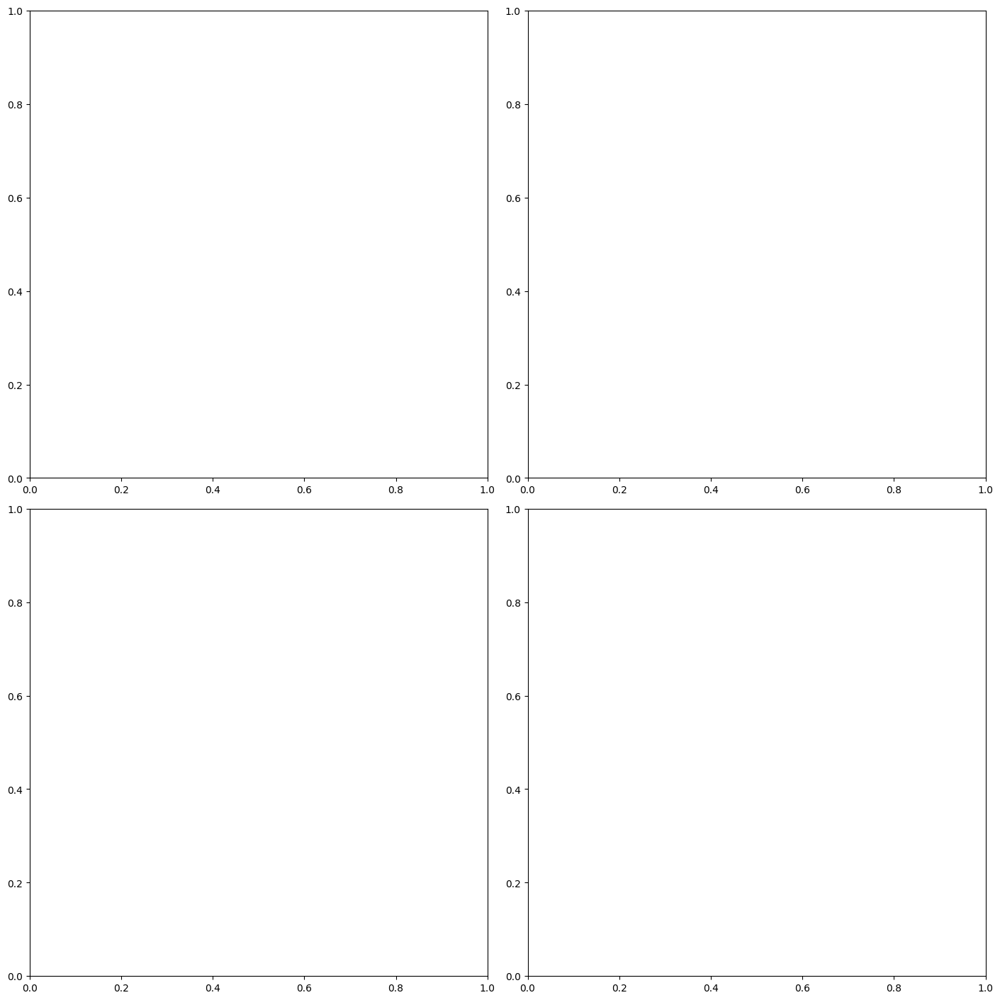

In [2]:
fig, axs = plt.subplots(2, 2, figsize=(14, 14), constrained_layout=True)
example_image, example_mask = examples[0]
example_image = np.array(example_image)
example_mask = np.squeeze(example_mask)
axs[0][0].imshow(example_image)
axs[0][1].hist(example_image[:, :, 0].ravel(), bins = 256, color = 'red', alpha = 0.5)
axs[0][1].hist(example_image[:, :, 1].ravel(), bins = 256, color = 'Green', alpha = 0.5)
axs[0][1].hist(example_image[:, :, 2].ravel(), bins = 256, color = 'Blue', alpha = 0.5)

axs[1][0].imshow(example_mask)
histogram, bin_edges = np.histogram(example_mask, bins=256)
axs[1][1].plot(bin_edges[0:-1], histogram)
;

In [165]:
@tf.function
def resize_images(images, masks, max_image_size=1500):
    shape = tf.shape(images)
    scale = (tf.reduce_max(shape) // max_image_size) + 1
    target_height, target_width = shape[-3] // scale, shape[-2] // scale
    images = tf.cast(images, tf.float32)
    masks = tf.cast(masks, tf.float32)
    if scale != 1:
        images = tf.image.resize(images, (target_height, target_width), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
        masks = tf.image.resize(masks, (target_height, target_width), method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
    return (images, masks)

@tf.function
def scale_values(images, masks, mask_split_threshold = 128):
    images = tf.math.divide(images, 255)
    masks = tf.where(masks > mask_split_threshold, 1, 0)
    return (images, masks)

@tf.function
def pad_images(images, masks, pad_mul=16, offset=0):
    shape = tf.shape(images)
    height, width = shape[-3], shape[-2]
    target_height = height + tf.math.floormod(tf.math.negative(height), pad_mul)
    target_width = width + tf.math.floormod(tf.math.negative(width), pad_mul)
    images = tf.image.pad_to_bounding_box(images, offset, offset, target_height, target_width)
    masks = tf.cast(tf.image.pad_to_bounding_box(masks, offset, offset, target_height, target_width), tf.uint8)
    return (images, masks)

In [185]:
batch_size = 8
test_set_size = 200
validation_set_size =100 

dataset = tf.data.Dataset.list_files(images_dir + '/*.jpg', seed=42)

test_dataset = dataset.take(test_set_size)
dataset = dataset.skip(test_set_size)
test_dataset = test_dataset.map(load_img_with_mask)
test_dataset = test_dataset.map(scale_values)
test_dataset = test_dataset.shuffle(20)
test_dataset = test_dataset.map(lambda img, mask: resize_images(img, mask, max_image_size=2500))
test_dataset = test_dataset.map(pad_images)
test_dataset = test_dataset.batch(1).prefetch(5)


validation_dataset = dataset.take(validation_set_size)
train_dataset = dataset.skip(validation_set_size)
validation_dataset = validation_dataset.map(load_img_with_mask)
validation_dataset = validation_dataset.map(scale_values)
validation_dataset = validation_dataset.shuffle(20)
validation_dataset = validation_dataset.map(resize_images)
validation_dataset = validation_dataset.map(pad_images)
validation_dataset = validation_dataset.batch(1).prefetch(5)

train_dataset = train_dataset.map(load_img_with_mask)
train_dataset = train_dataset.map(scale_values)
train_dataset = train_dataset.shuffle(20)
train_dataset = train_dataset.map(resize_images)
train_dataset = train_dataset.map(pad_images)
train_dataset = train_dataset.batch(1).prefetch(5)

In [186]:
def get_unet(hidden_activation='relu', initializer='he_normal', output_activation='sigmoid'):
    PartialConv = partial(keras.layers.Conv2D,
     activation=hidden_activation,
     kernel_initializer=initializer,      
     padding='same')
    
    # Encoder
    model_input = keras.layers.Input(shape=(None, None, 3))
    enc_cov_1 = PartialConv(16, 3)(model_input)
    enc_cov_1 = PartialConv(16, 3)(enc_cov_1)
    enc_pool_1 = keras.layers.MaxPooling2D(pool_size=(2, 2))(enc_cov_1)
    
    enc_cov_2 = PartialConv(32, 3)(enc_pool_1)
    enc_cov_2 = PartialConv(32, 3)(enc_cov_2)
    enc_pool_2 = keras.layers.MaxPooling2D(pool_size=(2, 2))(enc_cov_2)
    
    enc_cov_3 = PartialConv(64, 3)(enc_pool_2)
    enc_cov_3 = PartialConv(64, 3)(enc_cov_3)
    enc_pool_3 = keras.layers.MaxPooling2D(pool_size=(2, 2))(enc_cov_3)
    
    # Center
    center_cov = PartialConv(128, 3)(enc_pool_3)
    center_cov = PartialConv(128, 3)(center_cov)
    
    # Decoder
    upsampling1 = keras.layers.UpSampling2D(size=(2, 2))(center_cov)
    dec_up_conv_1 = PartialConv(64, 2)(upsampling1)
    dec_merged_1 = tf.keras.layers.Concatenate(axis=3)([enc_cov_3, dec_up_conv_1])
    dec_conv_1 = PartialConv(64, 3)(dec_merged_1)
    dec_conv_1 = PartialConv(64, 3)(dec_conv_1)
    
    upsampling2 = keras.layers.UpSampling2D(size=(2, 2))(dec_conv_1)
    dec_up_conv_2 = PartialConv(32, 2)(upsampling2)
    dec_merged_2 = tf.keras.layers.Concatenate(axis=3)([enc_cov_2, dec_up_conv_2])
    dec_conv_2 = PartialConv(32, 3)(dec_merged_2)
    dec_conv_2 = PartialConv(32, 3)(dec_conv_2)
    
    upsampling3 = keras.layers.UpSampling2D(size=(2, 2))(dec_conv_2)
    dec_up_conv_3 = PartialConv(16, 2)(upsampling3)
    dec_merged_3 = tf.keras.layers.Concatenate(axis=3)([enc_cov_1, dec_up_conv_3])
    dec_conv_3 = PartialConv(16, 3)(dec_merged_3)
    dec_conv_3 =  PartialConv(16, 3)(dec_conv_3)
    
    output = keras.layers.Conv2D(1, 1, activation=output_activation)(dec_conv_3)
    
    return tf.keras.Model(inputs=model_input, outputs=output)

In [187]:
model = get_unet()

optimizer = tf.keras.optimizers.Nadam()
model.compile(loss='binary_crossentropy', optimizer=optimizer)

In [138]:
model.summary()

Model: "model_7"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_8 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d_126 (Conv2D)            (None, None, None,   448         ['input_8[0][0]']                
                                16)                                                               
                                                                                                  
 conv2d_127 (Conv2D)            (None, None, None,   2320        ['conv2d_126[0][0]']             
                                16)                                                         

                                                                                                  
 conv2d_143 (Conv2D)            (None, None, None,   17          ['conv2d_142[0][0]']             
                                1)                                                                
                                                                                                  
Total params: 482,033
Trainable params: 482,033
Non-trainable params: 0
__________________________________________________________________________________________________


In [189]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)
lr_reduce = tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.3, patience=3, verbose=1)

epochs = 5
history = model.fit(train_dataset, validation_data=validation_dataset, epochs=epochs, callbacks=[early_stopping, lr_reduce])

Epoch 1/5
672/672 [==============================] - 599s 889ms/step - loss: 0.4021 - val_loss: 0.3545 - lr: 0.0010
Epoch 2/5
672/672 [==============================] - 645s 960ms/step - loss: 0.4101 - val_loss: 0.4189 - lr: 0.0010
Epoch 3/5
672/672 [==============================] - 625s 930ms/step - loss: 0.3879 - val_loss: 0.3961 - lr: 0.0010
Epoch 4/5
672/672 [==============================] - ETA: 0s - loss: 0.3917
Epoch 4: ReduceLROnPlateau reducing learning rate to 0.0003000000142492354.
672/672 [==============================] - 637s 949ms/step - loss: 0.3917 - val_loss: 0.3573 - lr: 0.0010
Epoch 5/5
672/672 [==============================] - 658s 980ms/step - loss: 0.3593 - val_loss: 0.3673 - lr: 3.0000e-04


1/1 [==============================] - 1s 1s/step


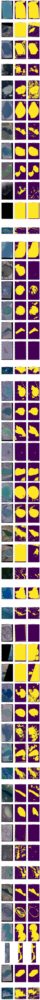

In [190]:
n_examples = 50

fig, axs = plt.subplots(n_examples, 3, figsize=(14, n_examples*7), constrained_layout=True)
y=[]
img=[]
for ax, ele in zip(axs, test_dataset.take(n_examples)):
    image, y_true = ele
    #print(image)
    img.append(image)
    y.append(y_true)
    prediction = model.predict(image)[0]
    prediction = tf.where(prediction > 0.5, 255, 0)
    ax[0].set_title('Original image')
    ax[0].imshow(image[0])
    ax[1].set_title('Original mask')
    ax[1].imshow(y_true[0])
    ax[2].set_title('Predicted area')
    ax[2].imshow(prediction)

In [83]:
a=Image.open("C:/Users/SHASANK DIXIT/Desktop/DST PROJECT/Water Bodies Dataset/Images/water_body_8952.jpg")
img_array = np.array(a)

In [147]:
img[0]

<tf.Tensor: shape=(1, 384, 368, 3), dtype=float32, numpy=
array([[[[0.        , 0.01568628, 0.        ],
         [0.        , 0.01176471, 0.        ],
         [0.        , 0.00784314, 0.        ],
         ...,
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ]],

        [[0.        , 0.01176471, 0.00392157],
         [0.        , 0.00784314, 0.        ],
         [0.        , 0.00784314, 0.        ],
         ...,
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ]],

        [[0.00392157, 0.03921569, 0.03529412],
         [0.00392157, 0.03921569, 0.02745098],
         [0.        , 0.03529412, 0.03137255],
         ...,
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ],
         [0.        , 0.        , 0.        ]],

        ...,

        [[0.        , 0.        , 

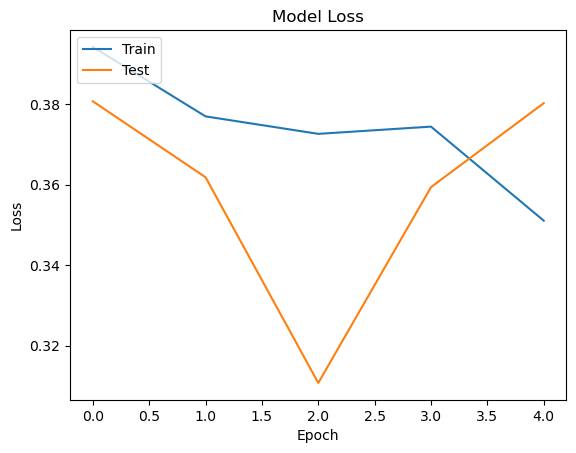

In [144]:
# plot model loss over training and validation data
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Test'], loc='upper left')
plt.show()

In [161]:

meanIoU = tf.keras.metrics.MeanIoU(num_classes=2)

image, y_true = img[17],y[17]
Y=y_true[0]
Y=Y.numpy()
Y=Y.reshape(-1)
prediction = model.predict(image)[0]
prediction = tf.where(prediction > 0.5, 1, 0)
prediction1=prediction.numpy()
prediction1=prediction1.reshape(-1)
#prediction1=prediction[:, 0]
meanIoU.update_state(y_true[0], prediction)
p = sklearn.metrics.precision_score(Y,prediction1)
r=sklearn.metrics.recall_score(Y,prediction1)
acc=sklearn.metrics.accuracy_score(Y,prediction1)
print("accuracy : ",acc)
print("Intersection over union :",meanIoU.result().numpy())
print("precision :", p)
print("Recall :", r)

1/1 [==============================] - 0s 125ms/step
accuracy :  0.9225775271045918
Intersection over union : 0.79534817
precision : 0.988433692389193
Recall : 0.6891916849643964


In [124]:
print("precision :", np.mean(precision))
print("Recall :", np.mean(recall))
print("Intersection over union (IOU):",meanIoU.result().numpy())

print("accuracy : ",np.mean(accu))

precision : 0.7717843314131007
Recall : 0.7261771299739748
Intersection over union (IOU): 0.72608936
accuracy :  0.7587981551658451
